#Mnist-fashion-classification

##Download Data from Kaggle

In [8]:
 !pip install kaggle --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [9]:
!mkdir ~/.kaggle


mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [10]:
! cp kaggle.json ~/.kaggle

In [11]:
!chmod 600 ~/.kaggle/kaggle.json

In [12]:
!kaggle --version

Kaggle API 1.5.12


In [13]:
!kaggle datasets download -d zalando-research/fashionmnist

 99% 68.0M/68.8M [00:04<00:00, 23.0MB/s]
100% 68.8M/68.8M [00:04<00:00, 17.9MB/s]


In [16]:
!unzip /content/fashionmnist.zip

Archive:  /content/fashionmnist.zip
  inflating: fashion-mnist_test.csv  
  inflating: fashion-mnist_train.csv  
  inflating: t10k-images-idx3-ubyte  
  inflating: t10k-labels-idx1-ubyte  
  inflating: train-images-idx3-ubyte  
  inflating: train-labels-idx1-ubyte  


##Data Loading 


In [19]:
import numpy as np
import pandas as pd 

In [20]:
#read train and test files
df_train = pd.read_csv('fashion-mnist_train.csv')
df_test = pd.read_csv('fashion-mnist_test.csv')

##Data exploration

###training data

In [21]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 785 entries, label to pixel784
dtypes: int64(785)
memory usage: 359.3 MB


In [22]:
df_train.shape

(60000, 785)

In [23]:
df_train.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
0,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,0,0,0,5,0,...,0,0,0,30,43,0,0,0,0,0
3,0,0,0,0,1,2,0,0,0,0,...,3,0,0,0,0,1,0,0,0,0
4,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [24]:
df_train.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,...,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.00000
mean,4.500000,0.000900,0.006150,0.035333,0.101933,0.247967,0.411467,0.805767,2.198283,5.682000,...,34.625400,23.300683,16.588267,17.869433,22.814817,17.911483,8.520633,2.753300,0.855517,0.07025
std,2.872305,0.094689,0.271011,1.222324,2.452871,4.306912,5.836188,8.215169,14.093378,23.819481,...,57.545242,48.854427,41.979611,43.966032,51.830477,45.149388,29.614859,17.397652,9.356960,2.12587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
50%,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,58.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
max,9.000000,16.000000,36.000000,226.000000,164.000000,227.000000,230.000000,224.000000,255.000000,254.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,170.00000


In [25]:
# # heat correlation map to check identical faetures
# plt.figure(figsize = (30, 20))
# sns.heatmap(df_train.corr(), annot = True, cmap = 'coolwarm', center = 0)
# plt.title('Correlation Matrix')

In [26]:
df_train.isnull().sum()

label       0
pixel1      0
pixel2      0
pixel3      0
pixel4      0
           ..
pixel780    0
pixel781    0
pixel782    0
pixel783    0
pixel784    0
Length: 785, dtype: int64

In [27]:
df_train.isnull().sum().sum()

0

In [28]:
#checking for duplicates values
df_train.duplicated().values.any()

True

In [29]:
df_train.shape

(60000, 785)

In [30]:
#drop the duplicated data
df_train=df_train.drop_duplicates()

In [31]:
df_train.shape

(59957, 785)

In [32]:
X_train_img=df_train.loc[:, df_train.columns != 'label']
y_train_label=df_train['label']

In [33]:
print("X_train_img shape:", X_train_img.shape)
print("y_train_label shape:", y_train_label.shape)

X_train_img shape: (59957, 784)
y_train_label shape: (59957,)


####label

In [34]:
y_train_label.value_counts()

5    6000
8    6000
9    5998
0    5998
3    5997
7    5996
1    5996
4    5995
6    5989
2    5988
Name: label, dtype: int64

Labels

Each training and test example is assigned to one of the following labels:

0 T-shirt/top

1 Trouser

2 Pullover

3 Dress

4 Coat

5 Sandal

6 Shirt

7 Sneaker

8 Bag

9 Ankle boot

In [35]:
y_train_label.value_counts(normalize=True)

5    0.100072
8    0.100072
9    0.100038
0    0.100038
3    0.100022
7    0.100005
1    0.100005
4    0.099988
6    0.099888
2    0.099872
Name: label, dtype: float64

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


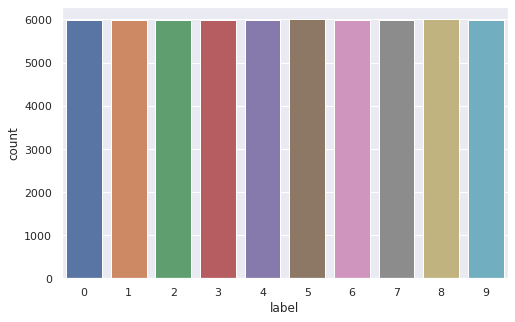

In [36]:
plt.figure(figsize=(8,5))
ax = sns.countplot(y_train_label)
plt.show()

####display images

In [37]:
import matplotlib.pyplot as plt
def display_images(img,label,img_row,img_col,num_row,num_col):
  class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
  # get a segment of the dataset
  num = num_row*num_col
  images = img[:num]
  labels = label[:num]

  # plot images
  fig, axes = plt.subplots(num_row, num_col, figsize=(12,8))
  for i in range(num_row*num_col):
    ax = axes[i//num_col, i%num_col]
    ax.axis('off')
    ax.imshow(np.array(img.iloc[i, :]).reshape(img_row,img_col))
    ax.set_title(class_names[label[i]])
    #ax.set_title('Label: {}'.format(labels[i]))
  plt.tight_layout()
  plt.show()

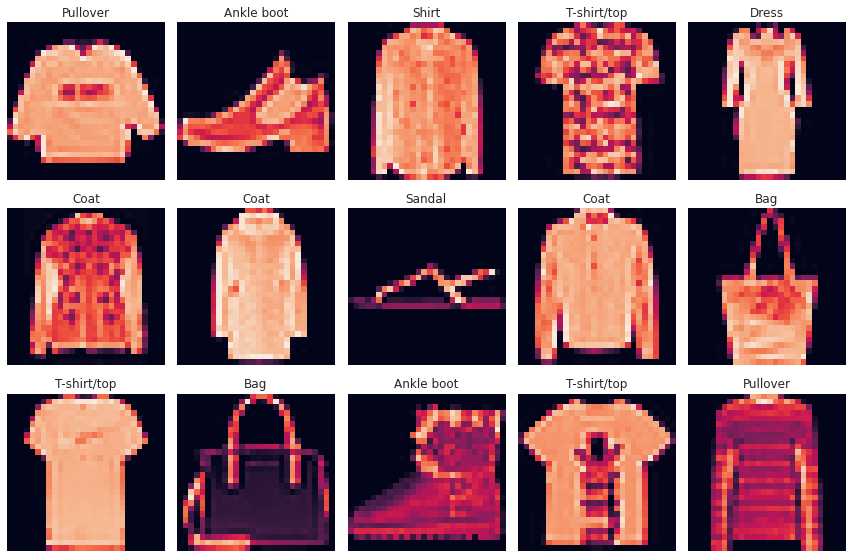

In [38]:
display_images(X_train_img,y_train_label,28,28,3,5)

###test data

In [39]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Columns: 785 entries, label to pixel784
dtypes: int64(785)
memory usage: 59.9 MB


In [40]:
df_test.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
0,0,0,0,0,0,0,0,0,9,8,...,103,87,56,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,34,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,14,53,99,...,0,0,0,0,63,53,31,0,0,0
3,2,0,0,0,0,0,0,0,0,0,...,137,126,140,0,133,224,222,56,0,0
4,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [41]:
df_test.shape

(10000, 785)

In [42]:
X_test_img=df_test.loc[:, df_test.columns != 'label']
y_test_label=df_test['label']

In [43]:
print("X_test_img shape:", X_test_img.shape)
print("y_test_label shape:", y_test_label.shape)

X_test_img shape: (10000, 784)
y_test_label shape: (10000,)


####label

In [44]:
y_test_label.value_counts()

0    1000
1    1000
2    1000
3    1000
8    1000
6    1000
5    1000
4    1000
7    1000
9    1000
Name: label, dtype: int64

In [45]:
y_test_label.value_counts(normalize=True)

0    0.1
1    0.1
2    0.1
3    0.1
8    0.1
6    0.1
5    0.1
4    0.1
7    0.1
9    0.1
Name: label, dtype: float64

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


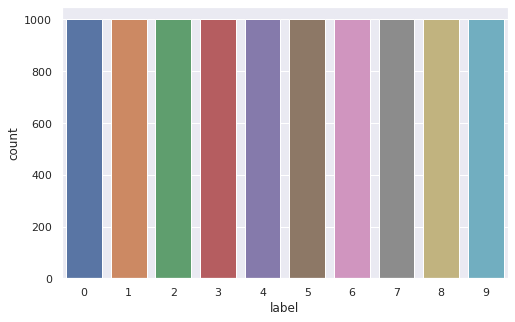

In [46]:
plt.figure(figsize=(8,5))
ax = sns.countplot(y_test_label)
plt.show()

####display images

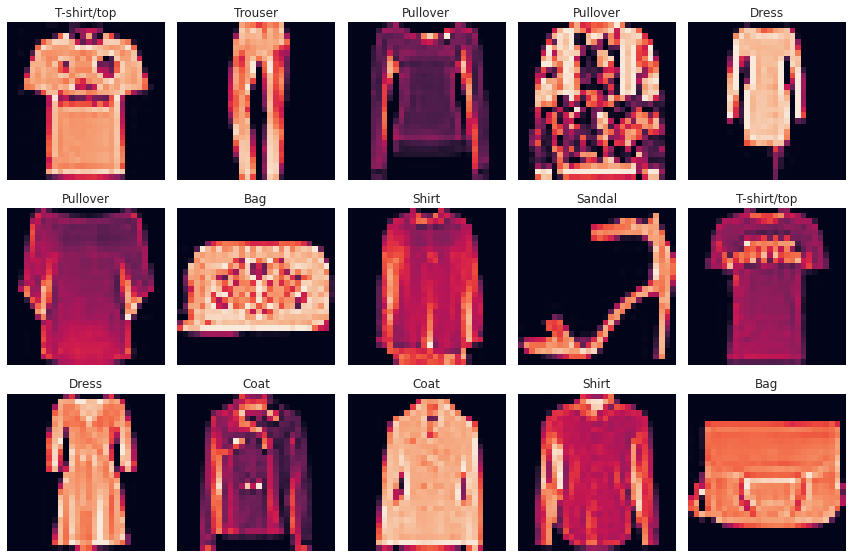

In [47]:
display_images(X_test_img,y_test_label,28,28,3,5)

##preprocessing

In [39]:
def prepare_data(img,label,img_row,img_col):
  X = np.array(img)
  y=to_categorical(np.array(label))
  X= X.reshape(img.shape[0], img_row, img_col, 1)
  X =X / 255
  return X,y

In [40]:
X_train,y_train=prepare_data(X_train_img,y_train_label,28,28)

In [41]:
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

X_train shape: (59957, 28, 28, 1)
y_train shape: (59957, 10)


In [42]:
X_test,y_test=prepare_data(X_test_img,y_test_label,28,28)

In [43]:
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)

X_test shape: (10000, 28, 28, 1)
y_test shape: (10000, 10)


##Helper

In [74]:
def train_val_loss_plt_model(history):
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(25,7))
  fig.suptitle('Model results')
  ax1.plot(history.history['accuracy'], 'b')
  ax1.plot(history.history['val_accuracy'], 'r')
  ax1.set_title('model accuracy')
  ax1.set_ylabel('accuracy')
  ax1.set_xlabel('epochs')
  ax1.legend(['tr_model_acc', 'val_model_acc'])
  ax1.grid()
  ax2.plot(history.history['loss'], 'b')
  ax2.plot(history.history['val_loss'], 'r')
  ax2.set_title('model loss')
  ax2.set_ylabel('loss')
  ax2.set_xlabel('epoch')
  ax2.legend(['tr_model_loss', 'val_model_loss'])
  ax2.grid()
  plt.show()

In [44]:
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.python import keras
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, Conv2D, Dropout, MaxPooling2D
from tensorflow.keras.optimizers import  Adam
from keras.callbacks import EarlyStopping,TensorBoard
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Input, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, Dropout,BatchNormalization
from keras.layers import Activation,Add 
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import KFold 
from sklearn.model_selection import cross_val_score
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier

##Trial_1 (letNet-5)

In [ ]:
#build the letNet-5 model architecture
num_classes = 10

model = Sequential()

model.add(Conv2D(6, kernel_size=(3, 3), activation='relu', input_shape=(28,28,1)))
model.add(AveragePooling2D())

model.add(Conv2D(16, kernel_size=(3, 3), activation='relu'))
model.add(AveragePooling2D())

model.add(Flatten())

model.add(Dense(120, activation='relu'))

model.add(Dense(84, activation='relu'))

model.add(Dense(num_classes, activation = 'softmax'))

In [ ]:
model.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(), metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 6)         60        
                                                                 
 average_pooling2d (AverageP  (None, 13, 13, 6)        0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 11, 11, 16)        880       
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)                                                     
                                                                 
 flatten (Flatten)           (None, 400)               0         
                                                                 
 dense (Dense)               (None, 120)               4

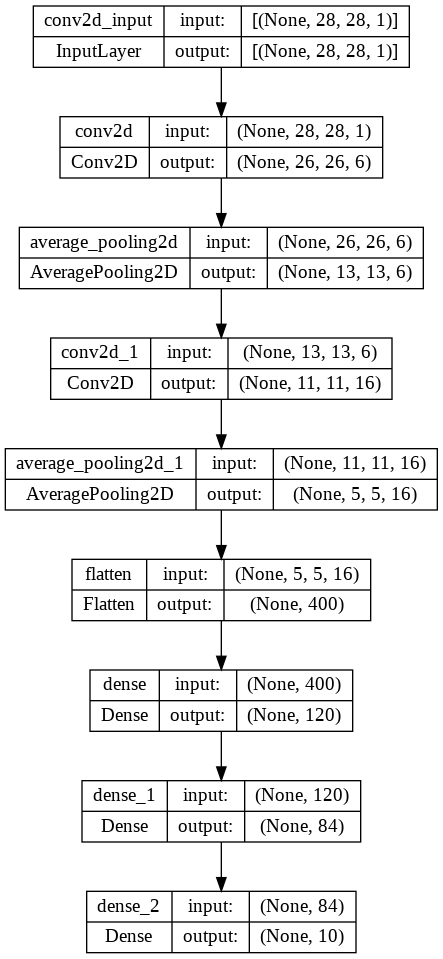

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
history = model.fit(X_train, y_train,
                    epochs=10,
                    batch_size = 128,
                    validation_split = 0.2,  
                    callbacks=tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3),
                    verbose = 1)

Epoch 1/10
375/375 [==============================] - 19s 48ms/step - loss: 0.7821 - accuracy: 0.7137 - val_loss: 0.5749 - val_accuracy: 0.7860
Epoch 2/10
375/375 [==============================] - 19s 51ms/step - loss: 0.5230 - accuracy: 0.7979 - val_loss: 0.5096 - val_accuracy: 0.8083
Epoch 3/10
375/375 [==============================] - 27s 71ms/step - loss: 0.4685 - accuracy: 0.8235 - val_loss: 0.4498 - val_accuracy: 0.8370
Epoch 4/10
375/375 [==============================] - 17s 46ms/step - loss: 0.4293 - accuracy: 0.8403 - val_loss: 0.4196 - val_accuracy: 0.8466
Epoch 5/10
375/375 [==============================] - 17s 46ms/step - loss: 0.3995 - accuracy: 0.8529 - val_loss: 0.4073 - val_accuracy: 0.8519
Epoch 6/10
375/375 [==============================] - 17s 46ms/step - loss: 0.3809 - accuracy: 0.8600 - val_loss: 0.3742 - val_accuracy: 0.8647
Epoch 7/10
375/375 [==============================] - 17s 47ms/step - loss: 0.3620 - accuracy: 0.8672 - val_loss: 0.4041 - val_accuracy:

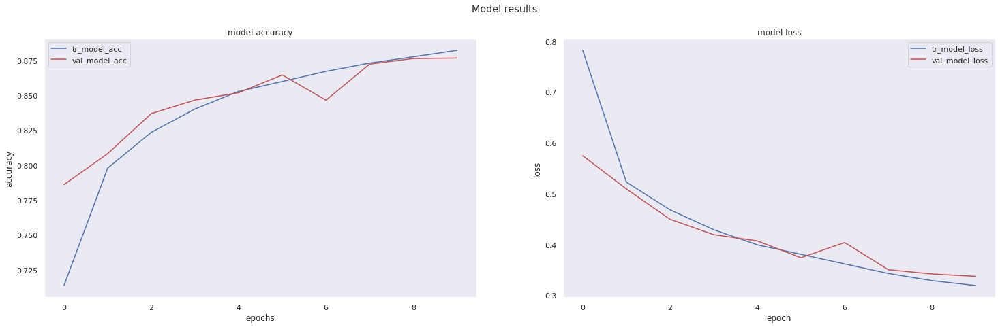

In [ ]:
train_val_loss_plt_model(history)

In [ ]:
print("Evaluate LeNet5 Model")
model.evaluate(X_test,y_test)

Evaluate LeNet5 Model
313/313 [==============================] - 3s 8ms/step - loss: 0.3289 - accuracy: 0.8803


[0.3288637399673462, 0.880299985408783]

In [ ]:
#using 5-Folds cross validation
kfold = KFold(n_splits=5, shuffle=True, random_state=42)
estimator = KerasClassifier(build_fn=lambda:model, epochs=10, batch_size=32 ,verbose = 1)
results_2 = cross_val_score(estimator, X_train, y_train, cv=kfold)

<ipython-input-62-305d7d8d2572>:3: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  estimator = KerasClassifier(build_fn=lambda:model, epochs=10, batch_size=32 ,verbose = 1)


Epoch 1/10
1499/1499 [==============================] - 25s 17ms/step - loss: 0.3491 - accuracy: 0.8718
Epoch 2/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.3164 - accuracy: 0.8829
Epoch 3/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.2992 - accuracy: 0.8898
Epoch 4/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.2838 - accuracy: 0.8954
Epoch 5/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.2718 - accuracy: 0.8983
Epoch 6/10
1499/1499 [==============================] - 26s 18ms/step - loss: 0.2579 - accuracy: 0.9048
Epoch 7/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.2450 - accuracy: 0.9107
Epoch 8/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.2352 - accuracy: 0.9134
Epoch 9/10
1499/1499 [==============================] - 22s 15ms/step - loss: 0.2257 - accuracy: 0.9155
Epoch 10/10
375/375 [==============================] - 4s 11ms/s

In [ ]:
print("Evaluate LeNet5 Model")
model.evaluate(X_test,y_test)

Evaluate LeNet5 Model
313/313 [==============================] - 3s 8ms/step - loss: 0.4764 - accuracy: 0.9057


[0.4763790965080261, 0.9057000279426575]

##Trial_T2 (letNet-5) using ImageDataGenerator() and tensorboard 

In [ ]:
#build the letNet-5 model architecture
num_classes = 10

model_t2 = Sequential()
model_t2.add(Conv2D(6, kernel_size=(3, 3), activation='relu', input_shape=(28,28,1)))
model_t2.add(AveragePooling2D())
model_t2.add(Dropout(0.2))
model_t2.add(Conv2D(16, kernel_size=(3, 3), activation='relu'))
model_t2.add(AveragePooling2D())
model_t2.add(Dropout(0.2))
model_t2.add(Flatten())
model_t2.add(Dense(120, activation='relu'))
model_t2.add(Dense(84, activation='relu'))
model_t2.add(Dense(num_classes, activation = 'softmax'))

In [ ]:
model_t2.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(), metrics=['accuracy'])

In [ ]:
model_t2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 26, 26, 6)         60        
                                                                 
 average_pooling2d_2 (Averag  (None, 13, 13, 6)        0         
 ePooling2D)                                                     
                                                                 
 dropout (Dropout)           (None, 13, 13, 6)         0         
                                                                 
 conv2d_3 (Conv2D)           (None, 11, 11, 16)        880       
                                                                 
 average_pooling2d_3 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)                                                     
                                                                 
 dropout_1 (Dropout)         (None, 5, 5, 16)         

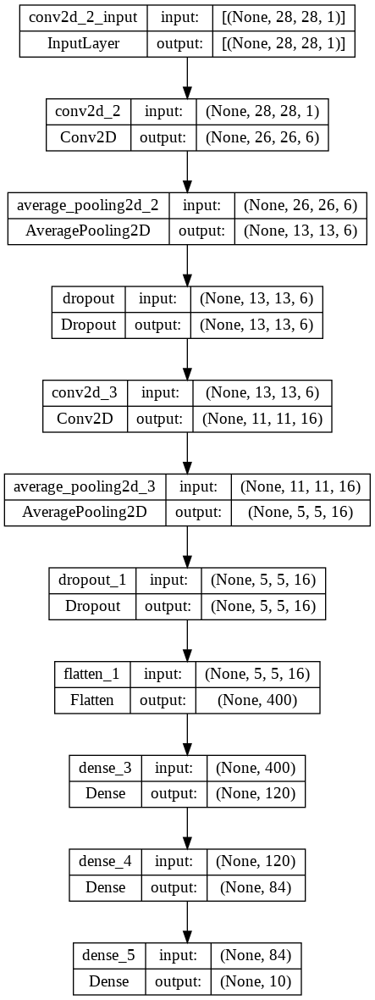

In [ ]:
tf.keras.utils.plot_model(model_t2, show_shapes=True)

In [ ]:
EPOCHS = 10
BATCH_SIZE = 128

In [ ]:
from sklearn.model_selection import train_test_split
# split data (training/testing set)
X_train_DG,X_val_DG, y_train_DG, y_val_DG = train_test_split(X_train,y_train, test_size=0.2, random_state=10)

train_generator = ImageDataGenerator().flow(X_train_DG, y_train_DG, batch_size=BATCH_SIZE)
validation_generator = ImageDataGenerator().flow(X_val_DG, y_val_DG, batch_size=BATCH_SIZE)

In [ ]:
print('# of training images:', X_train_DG.shape[0])
print('# of validation images:', X_val_DG.shape[0])

steps_per_epoch = X_train_DG.shape[0]//BATCH_SIZE
validation_steps = X_val_DG.shape[0]//BATCH_SIZE

tensorboard = TensorBoard(log_dir="logs/{}".format(time()))
earlystopping=EarlyStopping(monitor='val_loss', patience=3)
history_t2=model_t2.fit(train_generator, steps_per_epoch=steps_per_epoch, epochs=EPOCHS,
             validation_data=validation_generator, validation_steps=validation_steps,
                    shuffle=True, callbacks=[tensorboard,earlystopping])

# of training images: 47965
# of validation images: 11992
Epoch 1/10
374/374 [==============================] - 26s 68ms/step - loss: 0.8827 - accuracy: 0.6712 - val_loss: 0.6184 - val_accuracy: 0.7685
Epoch 2/10
374/374 [==============================] - 24s 65ms/step - loss: 0.6039 - accuracy: 0.7699 - val_loss: 0.5315 - val_accuracy: 0.7999
Epoch 3/10
374/374 [==============================] - 34s 91ms/step - loss: 0.5374 - accuracy: 0.7950 - val_loss: 0.4802 - val_accuracy: 0.8163
Epoch 4/10
374/374 [==============================] - 20s 54ms/step - loss: 0.5036 - accuracy: 0.8096 - val_loss: 0.4451 - val_accuracy: 0.8327
Epoch 5/10
374/374 [==============================] - 26s 69ms/step - loss: 0.4784 - accuracy: 0.8183 - val_loss: 0.4454 - val_accuracy: 0.8299
Epoch 6/10
374/374 [==============================] - 24s 64ms/step - loss: 0.4604 - accuracy: 0.8264 - val_loss: 0.4325 - val_accuracy: 0.8398
Epoch 7/10
374/374 [==============================] - 23s 62ms/step - loss: 0.

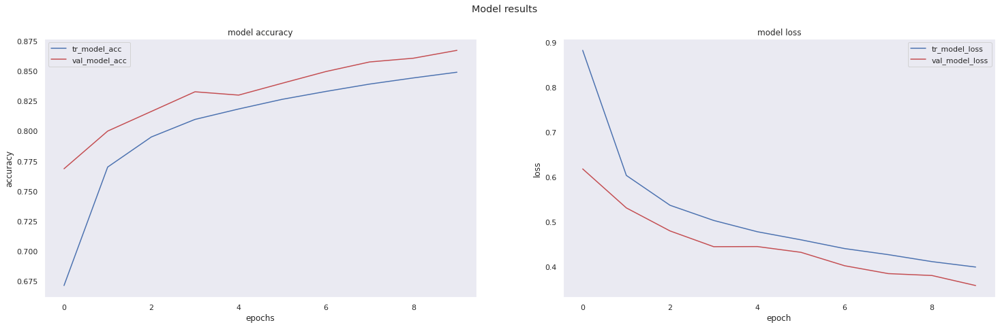

In [ ]:
train_val_loss_plt_model(history_t2)

In [ ]:
score = model_t2.evaluate(X_test,y_test)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

313/313 [==============================] - 5s 15ms/step - loss: 0.3432 - accuracy: 0.8715
Test loss: 0.34324154257774353
Test accuracy: 0.8715000152587891


##Trial_T3 (letNet-5) using ImageDataGenerator() and 5-fold cross-validation and Tensorboard

------------------------------------------------------------------------
Training for fold 1 ...
Epoch 1/10
374/374 [==============================] - 25s 65ms/step - loss: 0.8330 - accuracy: 0.6908 - val_loss: 0.5707 - val_accuracy: 0.7782
Epoch 2/10
374/374 [==============================] - 22s 58ms/step - loss: 0.5764 - accuracy: 0.7793 - val_loss: 0.4894 - val_accuracy: 0.8126
Epoch 3/10
374/374 [==============================] - 25s 68ms/step - loss: 0.5189 - accuracy: 0.8015 - val_loss: 0.4612 - val_accuracy: 0.8310
Epoch 4/10
374/374 [==============================] - 20s 54ms/step - loss: 0.4853 - accuracy: 0.8145 - val_loss: 0.4582 - val_accuracy: 0.8212
Epoch 5/10
374/374 [==============================] - 20s 54ms/step - loss: 0.4588 - accuracy: 0.8245 - val_loss: 0.4172 - val_accuracy: 0.8473
Epoch 6/10
374/374 [==============================] - 21s 57ms/step - loss: 0.4377 - accuracy: 0.8351 - val_loss: 0.4022 - val_accuracy: 0.8487
Epoch 7/10
374/374 [===================

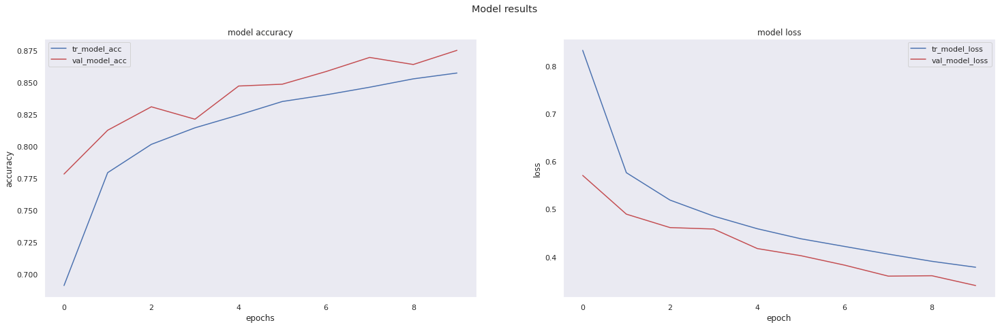

------------------------------------------------------------------------
> Fold 2 - Loss: 0.35566043853759766 - Accuracy: 87.04000115394592%


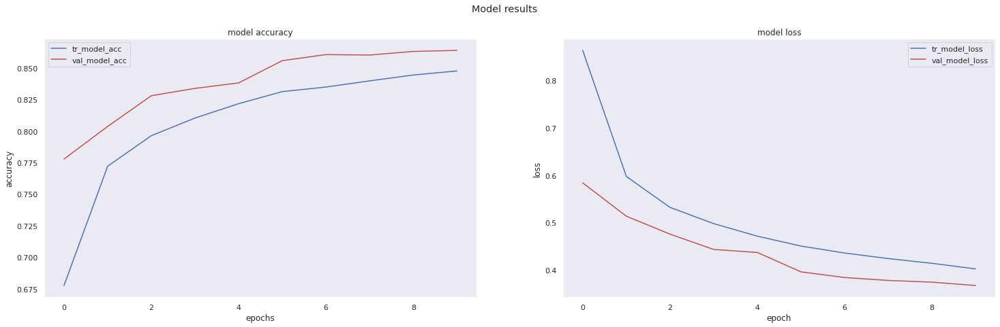

------------------------------------------------------------------------
> Fold 3 - Loss: 0.3535984456539154 - Accuracy: 86.65000200271606%


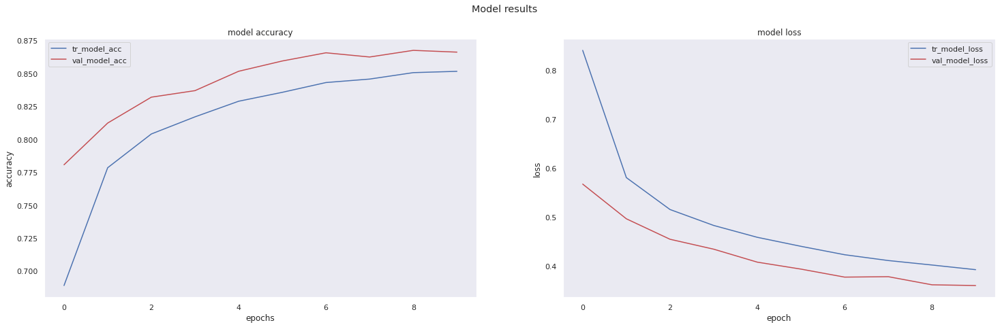

------------------------------------------------------------------------
> Fold 4 - Loss: 0.3352490961551666 - Accuracy: 87.73000240325928%


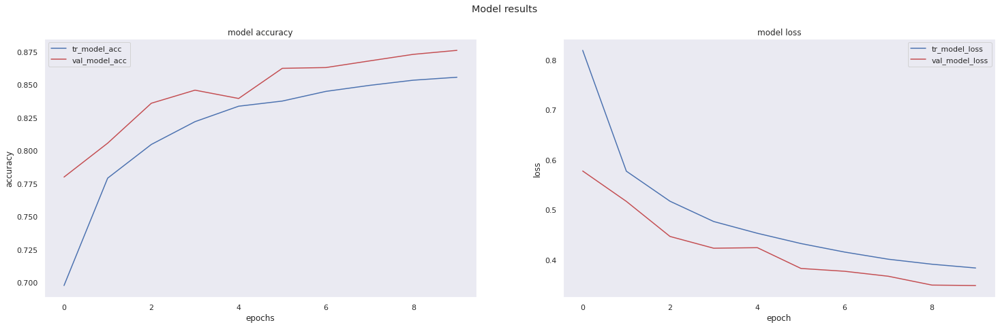

------------------------------------------------------------------------
> Fold 5 - Loss: 0.32468727231025696 - Accuracy: 87.73000240325928%


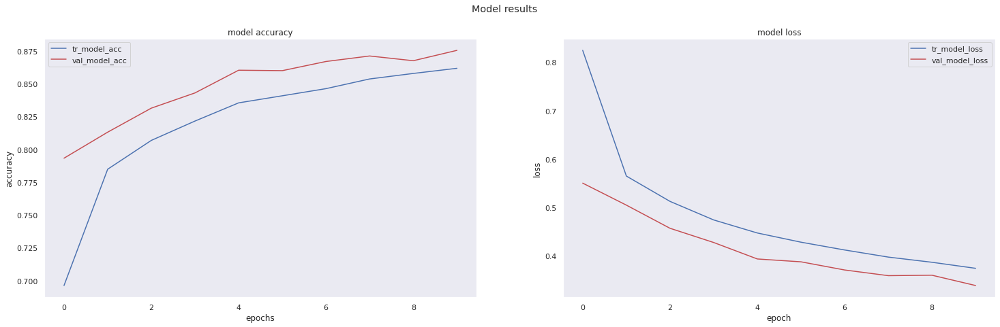

------------------------------------------------------------------------
Average scores for all folds:
> Accuracy: 87.43600130081177 (+- 0.5099641223874605)
> Loss: 0.33842504024505615
------------------------------------------------------------------------


In [ ]:
num_classes = 10
EPOCHS = 10
BATCH_SIZE = 128
# Define per-fold score containers
acc_per_fold_t3 = []
loss_per_fold_t3 = []
hist_per_fold_t3=[]
num_folds=5
X_train_DG,X_val_DG, y_train_DG, y_val_DG = train_test_split(X_train,y_train, test_size=0.2, random_state=10)
train_generator = ImageDataGenerator().flow(X_train_DG, y_train_DG, batch_size=BATCH_SIZE)
validation_generator = ImageDataGenerator().flow(X_val_DG, y_val_DG, batch_size=BATCH_SIZE)
steps_per_epoch = X_train_DG.shape[0]//BATCH_SIZE
validation_steps = X_val_DG.shape[0]//BATCH_SIZE
# Merge inputs and targets
inputs = np.concatenate((X_train, X_test), axis=0)
targets = np.concatenate((y_train, y_test), axis=0)

# Define the K-fold Cross Validator
kfold = KFold(n_splits=num_folds, shuffle=True)

# K-fold Cross Validation model evaluation
fold_no = 1
for train, test in kfold.split(inputs, targets):

  # Define the model architecture
  model_t3 = Sequential()
  model_t3.add(Conv2D(6, kernel_size=(3, 3), activation='relu', input_shape=(28,28,1)))
  model_t3.add(AveragePooling2D())
  model_t3.add(Dropout(0.2))
  model_t3.add(Conv2D(16, kernel_size=(3, 3), activation='relu'))
  model_t3.add(AveragePooling2D())
  model_t3.add(Dropout(0.2))
  model_t3.add(Flatten())
  model_t3.add(Dense(120, activation='relu'))
  model_t3.add(Dense(84, activation='relu'))
  model_t3.add(Dense(num_classes, activation = 'softmax'))


  # Compile the model
  model_t3.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(), metrics=['accuracy'])

  
  # Generate a print
  print('------------------------------------------------------------------------')
  print(f'Training for fold {fold_no} ...')

  # Fit data to model
  #fit the model with 10 epochs and using early stopping and using 20% validation set
  tensorboard = TensorBoard(log_dir="logs/{}".format(time()))
  earlystopping=EarlyStopping(monitor='val_loss', patience=3)
  history_t3=model_t3.fit(train_generator, steps_per_epoch=steps_per_epoch, epochs=EPOCHS,
              validation_data=validation_generator, validation_steps=validation_steps,
                      shuffle=True, callbacks=[tensorboard,earlystopping])

  # Generate generalization metrics
  scores = model_t3.evaluate(X_test, y_test, verbose=0)
  print(f'Score for fold {fold_no}: {model_t3.metrics_names[0]} of {scores[0]}; {model_t3.metrics_names[1]} of {scores[1]*100}%')
  acc_per_fold_t3.append(scores[1] * 100)
  loss_per_fold_t3.append(scores[0])
  hist_per_fold_t3.append(history_t3)

  # Increase fold number
  fold_no = fold_no + 1

# == Provide average scores ==
print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(acc_per_fold_t3)):
  print('------------------------------------------------------------------------')
  print(f'> Fold {i+1} - Loss: {loss_per_fold_t3[i]} - Accuracy: {acc_per_fold_t3[i]}%')
  train_val_loss_plt_model(hist_per_fold_t3[i])
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(acc_per_fold_t3)} (+- {np.std(acc_per_fold_t3)})')
print(f'> Loss: {np.mean(loss_per_fold_t3)}')
print('------------------------------------------------------------------------')

##Hyperparamter tunning by KerasTuner with TensorBoard

In [ ]:
!pip install keras-tuner -q

     |████████████████████████████████| 135 kB 7.7 MB/s 
     |████████████████████████████████| 1.6 MB 60.1 MB/s 


In [ ]:
import keras_tuner
from tensorflow.keras import layers
from tensorflow.keras.optimizers import  SGD, Adam, Adagrad, RMSprop

In [ ]:
num_classes = 10
def model_fun(conv2d_units,dense_unit,kernal_tune, rate):
    model = Sequential()
    model.add(Conv2D(conv2d_units, kernel_size=(kernal_tune, kernal_tune), activation='relu', input_shape=(28,28,1))) 
    model.add(AveragePooling2D())
    model.add(Dropout(rate))
    model.add(Conv2D(conv2d_units, kernel_size=(kernal_tune, kernal_tune), activation='relu'))
    model.add(AveragePooling2D())
    model.add(Dropout(rate))
    model.add(Flatten())
    model.add(Dense(dense_unit, activation='relu'))
    model.add(Dense(dense_unit, activation='relu'))
    model.add(Dense(num_classes, activation = 'softmax'))
    model.summary()
    model.compile(optimizer=keras.optimizers.Adam(), loss=keras.losses.categorical_crossentropy, metrics='accuracy')
    return model

In [ ]:
def build_model(hp):
    conv2d_units = hp.Int("conv2d_units", min_value=6, max_value=256, step=32)
    dense_unit = hp.Int("dense_unit", min_value=16, max_value=256, step=32)
    kernal_tune=hp.Choice('kernal_tune', values=[3,5,7])
    rate=hp.Choice("rate", values=[0.0,0.1,0.2,0.3,0.4,0.5])
    # call existing model_fun code with the hyperparameter values.
    model = model_fun(conv2d_units,dense_unit,kernal_tune, rate)
    return model

In [ ]:
build_model(keras_tuner.HyperParameters())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 6)         60        
                                                                 
 average_pooling2d (AverageP  (None, 13, 13, 6)        0         
 ooling2D)                                                       
                                                                 
 dropout (Dropout)           (None, 13, 13, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 11, 11, 6)         330       
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 6)          0         
 ePooling2D)                                                     
                                                                 
 dropout_1 (Dropout)         (None, 5, 5, 6)           0

In [ ]:
tuner = keras_tuner.RandomSearch(
    hypermodel=build_model,
    objective="val_loss",
    max_trials=8,
    executions_per_trial=1,
    overwrite=True,
    directory="dir",
    project_name="mnist",
)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 26, 26, 6)         60        
                                                                 
 average_pooling2d_2 (Averag  (None, 13, 13, 6)        0         
 ePooling2D)                                                     
                                                                 
 dropout_2 (Dropout)         (None, 13, 13, 6)         0         
                                                                 
 conv2d_3 (Conv2D)           (None, 11, 11, 6)         330       
                                                                 
 average_pooling2d_3 (Averag  (None, 5, 5, 6)          0         
 ePooling2D)                                                     
                                                                 
 dropout_3 (Dropout)         (None, 5, 5, 6)          

In [ ]:
tuner.search_space_summary()

Search space summary
Default search space size: 4
conv2d_units (Int)
{'default': None, 'conditions': [], 'min_value': 6, 'max_value': 256, 'step': 32, 'sampling': None}
dense_unit (Int)
{'default': None, 'conditions': [], 'min_value': 16, 'max_value': 256, 'step': 32, 'sampling': None}
kernal_tune (Choice)
{'default': 3, 'conditions': [], 'values': [3, 5, 7], 'ordered': True}
rate (Choice)
{'default': 0.0, 'conditions': [], 'values': [0.0, 0.1, 0.2, 0.3, 0.4, 0.5], 'ordered': True}


In [ ]:
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)

In [ ]:
tuner.search(X_train, y_train, epochs=10,validation_split=0.2, callbacks=[stop_early,keras.callbacks.TensorBoard("/tmp/tb_logs")])

Trial 8 Complete [00h 32m 23s]
val_loss: 0.2503298223018646

Best val_loss So Far: 0.24061577022075653
Total elapsed time: 02h 45m 59s


In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /tmp/tb_logs

<IPython.core.display.Javascript object>

In [ ]:
# Get the optimal hyperparameters
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]
print(f"""
The hyperparameter search is complete. 
The optimal number of conv2d_units  is >>>>>  {best_hps.get('conv2d_units')}
The optimal number of dense_unit  is >>>>>  {best_hps.get('dense_unit')}
the optimal drop rate is >>>>>  {best_hps.get('rate')}
the optimal kernal_tune is >>>>>  {best_hps.get('kernal_tune')}
""")


The hyperparameter search is complete. 
The optimal number of conv2d_units  is >>>>>  38
The optimal number of dense_unit  is >>>>>  112
the optimal drop rate is >>>>>  0.2
the optimal kernal_tune is >>>>>  3



In [ ]:
# Build the model with the optimal hyperparameters and train it on the data for 100 epochs
model = tuner.hypermodel.build(best_hps)
history = model.fit(X_train, y_train, epochs=10, validation_split=0.2)

val_acc_per_epoch = history.history['val_accuracy']
val_loss_per_epoch = history.history['val_loss']
best_epoch = val_loss_per_epoch.index(min(val_loss_per_epoch)) + 1
print('Best epoch: %d' % (best_epoch,))

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 26, 26, 38)        380       
                                                                 
 average_pooling2d_4 (Averag  (None, 13, 13, 38)       0         
 ePooling2D)                                                     
                                                                 
 dropout_4 (Dropout)         (None, 13, 13, 38)        0         
                                                                 
 conv2d_5 (Conv2D)           (None, 11, 11, 38)        13034     
                                                                 
 average_pooling2d_5 (Averag  (None, 5, 5, 38)         0         
 ePooling2D)                                                     
                                                                 
 dropout_5 (Dropout)         (None, 5, 5, 38)         

##Trial with best optimal hyperparameters


In [ ]:
hypermodel = tuner.hypermodel.build(best_hps)
hist_best=hypermodel.fit(X_train, y_train, epochs=best_epoch, validation_split=0.2)

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 26, 26, 38)        380       
                                                                 
 average_pooling2d_6 (Averag  (None, 13, 13, 38)       0         
 ePooling2D)                                                     
                                                                 
 dropout_6 (Dropout)         (None, 13, 13, 38)        0         
                                                                 
 conv2d_7 (Conv2D)           (None, 11, 11, 38)        13034     
                                                                 
 average_pooling2d_7 (Averag  (None, 5, 5, 38)         0         
 ePooling2D)                                                     
                                                                 
 dropout_7 (Dropout)         (None, 5, 5, 38)         

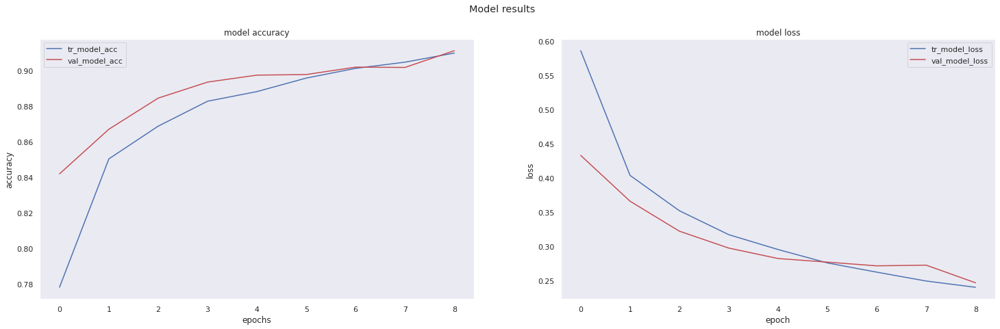

In [ ]:
train_val_loss_plt_model(hist_best)

In [ ]:
print("Model Evaluation ")
print("test loss, test acc:",hypermodel.evaluate(X_test, y_test))

Model Evaluation 
313/313 [==============================] - 4s 11ms/step - loss: 0.2343 - accuracy: 0.9138
test loss, test acc: [0.23429828882217407, 0.9138000011444092]


##Vgg

In [45]:
from keras.applications.vgg16 import VGG16

In [90]:
num_classes=len(np.unique(y_train_label))
num_classes

10

In [91]:
print("X_train_img shape:", X_train_img.shape)
print("y_train_label shape:", y_train_label.shape)

X_train_img shape: (59957, 784)
y_train_label shape: (59957,)


In [92]:
print("X_test_img shape:", X_test_img.shape)
print("y_test_label shape:", y_test_label.shape)

X_test_img shape: (10000, 784)
y_test_label shape: (10000,)


In [93]:
#The images of fashionMNIST are black and white, while the required input for VGG must be colored images(RGB)
X_train_img_vgg=np.dstack([X_train_img] * 3)
X_test_img_vgg=np.dstack([X_test_img] * 3)

In [94]:
print("X_train_img_vgg shape:", X_train_img_vgg.shape)
print("X_test_img_vgg shape:", X_test_img_vgg.shape)

X_train_img_vgg shape: (59957, 784, 3)
X_test_img_vgg shape: (10000, 784, 3)


In [95]:
# Reshape images as per the tensor format required by tensorflow
X_train_img_vgg = X_train_img_vgg.reshape(-1, 28,28,3)
X_test_img_vgg = X_test_img_vgg.reshape(-1, 28,28,3)

In [96]:
print("X_train_img_vgg shape:", X_train_img_vgg.shape)
print("X_test_img_vgg shape:", X_test_img_vgg.shape)

X_train_img_vgg shape: (59957, 28, 28, 3)
X_test_img_vgg shape: (10000, 28, 28, 3)


In [98]:
## Resize the images 48*48 as required by VGG16
from keras_preprocessing.image import img_to_array, array_to_img
X_train_img_vgg = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in X_train_img_vgg])
X_test_img_vgg = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in X_test_img_vgg])

In [99]:
print("X_train_img_vgg shape:", X_train_img_vgg.shape)
print("X_test_img_vgg shape:", X_test_img_vgg.shape)

X_train_img_vgg shape: (59957, 48, 48, 3)
X_test_img_vgg shape: (10000, 48, 48, 3)


In [100]:
## Normalise the data and change data type
X_train_img_vgg = X_train_img_vgg / 255.
X_train_img_vgg = X_train_img_vgg.astype('float32')
X_test_img_vgg = X_test_img_vgg / 255.
X_test_img_vgg = X_test_img_vgg.astype('float32')

In [101]:
y_train_label_vgg=to_categorical(np.array(y_train_label))
y_test_label_vgg=to_categorical(np.array(y_test_label))

In [102]:
base = VGG16(include_top=False, input_shape=(48,48,3)) 
base.trainable = False # freezing the weights

58889256/58889256 [==============================] - 3s 0us/step


In [103]:
base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 48, 48, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 48, 48, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 48, 48, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 24, 24, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 24, 24, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 24, 24, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 12, 12, 128)       0     

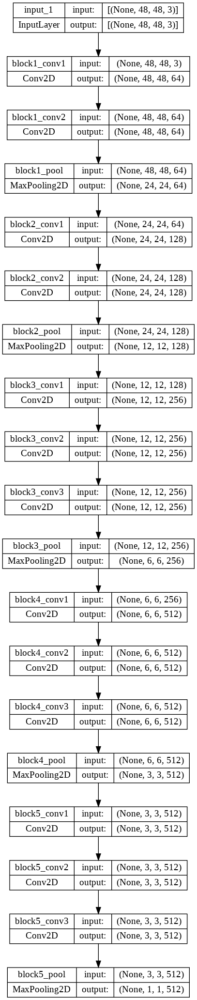

In [104]:
tf.keras.utils.plot_model(base, show_shapes=True)

In [106]:
model_vgg = Sequential()
model_vgg.add(base)
model_vgg.add(Flatten())
model_vgg.add(Dense(120, activation='relu'))
model_vgg.add(Dense(84, activation='relu'))
model_vgg.add(Dense(num_classes, activation = 'softmax'))

In [107]:
model_vgg.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 1, 1, 512)         14714688  
                                                                 
 flatten_1 (Flatten)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 120)               61560     
                                                                 
 dense_3 (Dense)             (None, 84)                10164     
                                                                 
 dense_4 (Dense)             (None, 10)                850       
                                                                 
Total params: 14,787,262
Trainable params: 72,574
Non-trainable params: 14,714,688
_________________________________________________________________


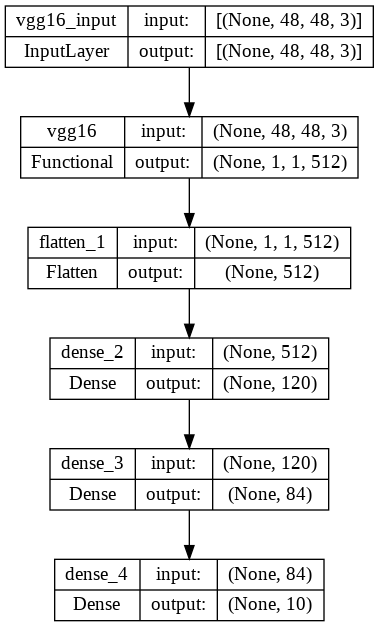

In [108]:
tf.keras.utils.plot_model(model_vgg, show_shapes=True)

In [109]:
model_vgg.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(), metrics=['accuracy'])

In [111]:
tensorboard = TensorBoard(log_dir="logs/{}".format(time()))
earlystopping=EarlyStopping(monitor='val_loss', patience=3)
history_vgg = model_vgg.fit(X_train_img_vgg, y_train_label_vgg,
                    epochs=10,
                    batch_size = 128,
                    validation_split = 0.2,  
                    callbacks=[tensorboard,earlystopping],
                    verbose = 1)

Epoch 1/10
375/375 [==============================] - 1463s 4s/step - loss: 0.6123 - accuracy: 0.7913 - val_loss: 0.4248 - val_accuracy: 0.8461
Epoch 2/10
375/375 [==============================] - 1456s 4s/step - loss: 0.4019 - accuracy: 0.8543 - val_loss: 0.4146 - val_accuracy: 0.8518
Epoch 3/10
375/375 [==============================] - 1450s 4s/step - loss: 0.3711 - accuracy: 0.8633 - val_loss: 0.3750 - val_accuracy: 0.8646
Epoch 4/10
375/375 [==============================] - 1491s 4s/step - loss: 0.3452 - accuracy: 0.8739 - val_loss: 0.3558 - val_accuracy: 0.8713
Epoch 5/10
375/375 [==============================] - 1440s 4s/step - loss: 0.3313 - accuracy: 0.8786 - val_loss: 0.3558 - val_accuracy: 0.8722
Epoch 6/10
375/375 [==============================] - 1441s 4s/step - loss: 0.3174 - accuracy: 0.8827 - val_loss: 0.3483 - val_accuracy: 0.8722
Epoch 7/10
375/375 [==============================] - 1440s 4s/step - loss: 0.3057 - accuracy: 0.8870 - val_loss: 0.3423 - val_accuracy:

In [116]:
%load_ext tensorboard

In [121]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

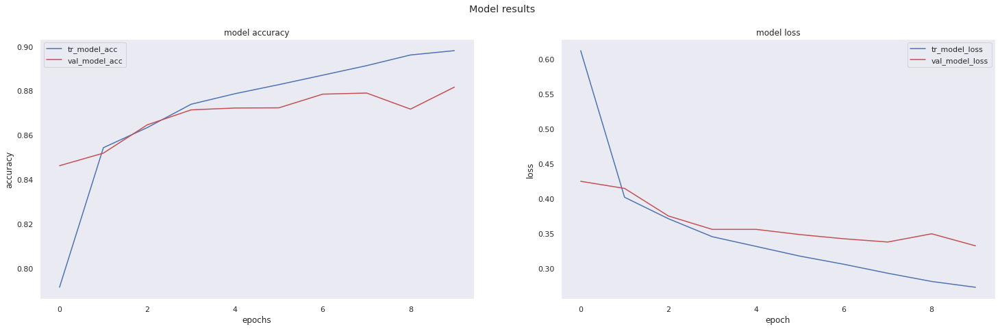

In [112]:
train_val_loss_plt_model(history_vgg)

In [115]:
score = model_vgg.evaluate(X_test_img_vgg,y_test_label_vgg)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

313/313 [==============================] - 243s 776ms/step - loss: 0.3189 - accuracy: 0.8826
Test loss: 0.3188993036746979
Test accuracy: 0.8826000094413757


##ResNet

In [61]:
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions

In [48]:
num_classes=len(np.unique(y_train_label))
num_classes

10

In [49]:
print("X_train_img shape:", X_train_img.shape)
print("y_train_label shape:", y_train_label.shape)

X_train_img shape: (59957, 784)
y_train_label shape: (59957,)


In [50]:
print("X_test_img shape:", X_test_img.shape)
print("y_test_label shape:", y_test_label.shape)

X_test_img shape: (10000, 784)
y_test_label shape: (10000,)


In [52]:
#The images of fashionMNIST are black and white, while the required input must be colored images(RGB)
X_train_img_resnet=np.dstack([X_train_img] * 3)
X_test_img_resnet=np.dstack([X_test_img] * 3)

In [53]:
print("X_train_img_vgg shape:", X_train_img_resnet.shape)
print("X_test_img_vgg shape:", X_test_img_resnet.shape)

X_train_img_vgg shape: (59957, 784, 3)
X_test_img_vgg shape: (10000, 784, 3)


In [54]:
# Reshape images as per the tensor format required by tensorflow
X_train_img_resnet = X_train_img_resnet.reshape(-1, 28,28,3)
X_test_img_resnet = X_test_img_resnet.reshape(-1, 28,28,3)

In [55]:
print("X_train_img_resnet shape:", X_train_img_resnet.shape)
print("X_test_img_resnet shape:", X_test_img_resnet.shape)

X_train_img_resnet shape: (59957, 28, 28, 3)
X_test_img_resnet shape: (10000, 28, 28, 3)


In [56]:
## Resize the images 48*48 as required by VGG16
from keras_preprocessing.image import img_to_array, array_to_img
X_train_img_resnet = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in X_train_img_resnet])
X_test_img_resnet = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in X_test_img_resnet])

In [57]:
print("X_train_img_resnet shape:", X_train_img_resnet.shape)
print("X_test_img_resnet shape:", X_test_img_resnet.shape)

X_train_img_resnet shape: (59957, 48, 48, 3)
X_test_img_resnet shape: (10000, 48, 48, 3)


In [58]:
## Normalise the data and change data type
X_train_img_resnet = X_train_img_resnet / 255.
X_train_img_resnet = X_train_img_resnet.astype('float32')
X_test_img_resnet = X_test_img_resnet / 255.
X_test_img_resnet = X_test_img_resnet.astype('float32')

In [59]:
y_train_label_resnet=to_categorical(np.array(y_train_label))
y_test_label_resnet=to_categorical(np.array(y_test_label))

In [62]:
base_resnet = ResNet50(weights='imagenet',include_top=False, input_shape=(48,48,3)) 
base_resnet.trainable = False # freezing the weights

In [63]:
base_resnet.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 48, 48, 3)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 54, 54, 3)    0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 24, 24, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 24, 24, 64)   256         ['conv1_conv[0][0]']             
                                                                                           

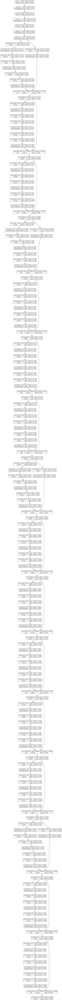

In [64]:
tf.keras.utils.plot_model(base_resnet, show_shapes=True)

In [66]:
model_resnet = Sequential()
model_resnet.add(base_resnet)
model_resnet.add(Flatten())
model_resnet.add(Dense(120, activation='relu'))
model_resnet.add(Dense(84, activation='relu'))
model_resnet.add(Dense(num_classes, activation = 'softmax'))

In [67]:
model_resnet.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2, 2, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 dense (Dense)               (None, 120)               983160    
                                                                 
 dense_1 (Dense)             (None, 84)                10164     
                                                                 
 dense_2 (Dense)             (None, 10)                850       
                                                                 
Total params: 24,581,886
Trainable params: 994,174
Non-trainable params: 23,587,712
_________________________________________________________________


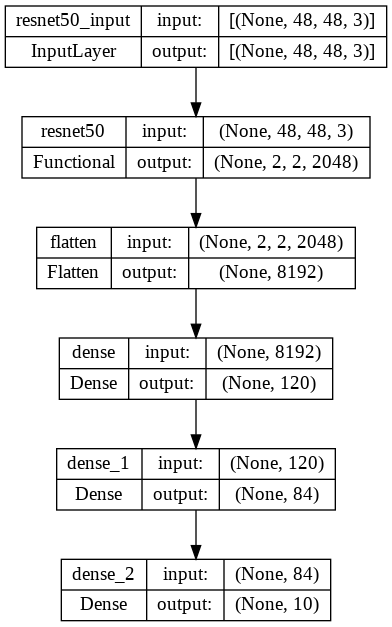

In [68]:
tf.keras.utils.plot_model(model_resnet, show_shapes=True)

In [69]:
model_resnet.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(), metrics=['accuracy'])

In [70]:
tensorboard = TensorBoard(log_dir="logs/{}".format(time()))
earlystopping=EarlyStopping(monitor='val_loss', patience=3)
history_resnet = model_resnet.fit(X_train_img_resnet, y_train_label_resnet,
                    epochs=10,
                    batch_size = 128,
                    validation_split = 0.2,  
                    callbacks=[tensorboard,earlystopping],
                    verbose = 1)

Epoch 1/10
375/375 [==============================] - 563s 1s/step - loss: 0.8439 - accuracy: 0.7024 - val_loss: 0.6430 - val_accuracy: 0.7723
Epoch 2/10
375/375 [==============================] - 552s 1s/step - loss: 0.5757 - accuracy: 0.7904 - val_loss: 0.6091 - val_accuracy: 0.7691
Epoch 3/10
375/375 [==============================] - 550s 1s/step - loss: 0.5327 - accuracy: 0.8038 - val_loss: 0.5369 - val_accuracy: 0.8052
Epoch 4/10
375/375 [==============================] - 550s 1s/step - loss: 0.4997 - accuracy: 0.8160 - val_loss: 0.6170 - val_accuracy: 0.7784
Epoch 5/10
375/375 [==============================] - 549s 1s/step - loss: 0.4855 - accuracy: 0.8207 - val_loss: 0.4877 - val_accuracy: 0.8248
Epoch 6/10
375/375 [==============================] - 549s 1s/step - loss: 0.4635 - accuracy: 0.8277 - val_loss: 0.4655 - val_accuracy: 0.8268
Epoch 7/10
375/375 [==============================] - 551s 1s/step - loss: 0.4488 - accuracy: 0.8343 - val_loss: 0.4455 - val_accuracy: 0.8392

In [71]:
%load_ext tensorboard

In [72]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6009 (pid 3886), started 3:18:09 ago. (Use '!kill 3886' to kill it.)

<IPython.core.display.Javascript object>

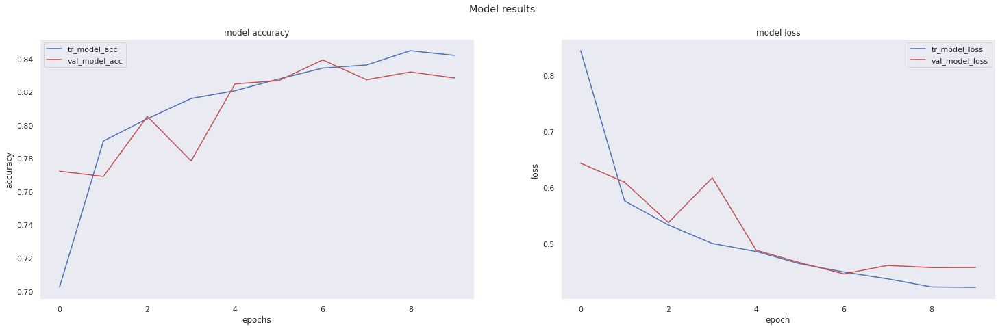

In [75]:
train_val_loss_plt_model(history_resnet)

In [77]:
score = model_resnet.evaluate(X_test_img_resnet,y_test_label_resnet)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

313/313 [==============================] - 96s 308ms/step - loss: 0.4379 - accuracy: 0.8363
Test loss: 0.43792083859443665
Test accuracy: 0.8363000154495239
